In [1]:
#1. Import libraries
using Random
Random.seed!(13)
import Pkg
Pkg.add("Convex")
Pkg.add("ECOS")
using CSV
using Plots
using DataFrames
using Statistics
using PyPlot
using Convex, ECOS
using LowRankModels
using StatsPlots, RDatasets; pyplot()

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
Fetching: [========================================>]  100.0 %.0 % [=======>                                 ]  17.4 %34.7 %>                   ]  52.1 %Fetching: [============================>            ]  68.5 %>     ]  85.8 % Resolving package versions...
 Installed FFMPEG ─────── v0.2.4
 Installed QuadGK ─────── v2.2.0
 Installed Polynomials ── v0.6.0
 Installed Optim ──────── v0.19.6
 Installed DecisionTree ─ v0.10.0
  Updating `~/.julia/environments/v1.2/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.2/Manifest.toml`
  [7806a523] ↑ DecisionTree v0.9.1 ⇒ v0.10.0
  [c87230d0] ↑ FFMPEG v0.2.3 ⇒ v0.2.4
  [429524aa] ↑ Optim v0.19.5 ⇒ v0.19.6
  [f27b6e38] + Polynomials v0.6.0
  [1fd47b50] ↑ QuadGK v2.1.1 ⇒ v2.2.0
  Building FFMPEG → `~/.julia/packages/FFMPEG/guN1x/deps/build.log`
 Resolving package versions...
  Updating `~/.julia/environments/v1.

┌ Info: Recompiling stale cache file /Users/silviaruiz/.julia/compiled/v1.2/Plots/ld3vC.ji for Plots [91a5bcdd-55d7-5caf-9e0b-520d859cae80]
└ @ Base loading.jl:1240
┌ Info: Recompiling stale cache file /Users/silviaruiz/.julia/compiled/v1.2/LowRankModels/1HEpm.ji for LowRankModels [15d4e49f-4837-5ea3-a885-5b28bfa376dc]
└ @ Base loading.jl:1240
┌ Info: Recompiling stale cache file /Users/silviaruiz/.julia/compiled/v1.2/StatsPlots/SiylL.ji for StatsPlots [f3b207a7-027a-5e70-b257-86293d7955fd]
└ @ Base loading.jl:1240


Plots.PyPlotBackend()

In [2]:
using LowRankModels 
include("proxgrad.jl")

proxgrad_const

## 1. Data Cleaning

In [3]:
#2. Read data
employee=CSV.read("employee_survey_data.csv")
general=CSV.read("general_data.csv")
manager=CSV.read("manager_survey_data.csv")

,EmployeeID,JobInvolvement,PerformanceRating
,Int64,Int64,Int64
1,1,3,3
2,2,2,4
3,3,3,3
4,4,2,3
5,5,3,3
6,6,3,3
7,7,3,4
8,8,3,4
9,9,3,4


In [4]:
#3. Merge data
full = join(manager, employee, on = :EmployeeID)
df=join(full, general , on = :EmployeeID)

,EmployeeID,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction
,Int64,Int64,Int64,String,String
1,1,3,3,3,4
2,2,2,4,3,2
3,3,3,3,2,2
4,4,2,3,4,4
5,5,3,3,4,1
6,6,3,3,3,2
7,7,3,4,1,3
8,8,3,4,1,2
9,9,3,4,2,4


In [5]:
#4. Check data
CSV.write("MergedData.csv",  df, writeheader=true)

"MergedData.csv"

In [6]:
#5. Predictors and their datatype
feature_names = names(df)
for i in 1:size(feature_names,1)
    println(string(i), "\t", string(feature_names[i]), "\t\t\t", string(eltype(df[!, i])))
end

1	EmployeeID			Int64
2	JobInvolvement			Int64
3	PerformanceRating			Int64
4	EnvironmentSatisfaction			String
5	JobSatisfaction			String
6	WorkLifeBalance			String
7	Age			Int64
8	Attrition			String
9	BusinessTravel			String
10	Department			String
11	DistanceFromHome			Int64
12	Education			Int64
13	EducationField			String
14	EmployeeCount			Int64
15	Gender			String
16	JobLevel			Int64
17	JobRole			String
18	MaritalStatus			String
19	MonthlyIncome			Int64
20	NumCompaniesWorked			String
21	Over18			String
22	PercentSalaryHike			Int64
23	StandardHours			Int64
24	StockOptionLevel			Int64
25	TotalWorkingYears			String
26	TrainingTimesLastYear			Int64
27	YearsAtCompany			Int64
28	YearsSinceLastPromotion			Int64
29	YearsWithCurrManager			Int64


In [7]:
#6. We will delete the columns that have the same value for each entrance (Over18, EmployeeCount, Standard Hours) and the employee ID
select!(df, Not(:Over18))
select!(df, Not(:EmployeeID))
select!(df, Not(:EmployeeCount))
select!(df, Not(:StandardHours))

,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance
,Int64,Int64,String,String,String
1,3,3,3,4,2
2,2,4,3,2,4
3,3,3,2,2,1
4,2,3,4,4,3
5,3,3,4,1,3
6,3,3,3,2,2
7,3,4,1,3,1
8,3,4,1,2,3
9,3,4,2,4,3


In [8]:
#7. These functions will help us convert some of the variables
"This function converts strings to floating point values.
Strings that cannot be represented as a number (like NA) are converted to zeros"
#Converts numbers stored as strings to float
function string_to_float(str)
    try
        parse(Float64, str)
    catch
       missing
    end
end
#Converts the attrition from "yes"/"no" to 1,-1
function attrition_num(str)
    if str=="Yes"
        return 1
    else
        return -1
    end
end
#Converts the attrition from "yes"/"no" to 1,0
function attrition_num2(str)
    if str=="Yes"
        return 1
    else
        return 0
    end
end
#Converts the gender from "Female"/"Male" to 1,0
function gender_num(str)
    if str=="Male"
        return 0
    else
        return 1
    end
end

gender_num (generic function with 1 method)

In [9]:
#8. First we will convert the variables that are numerical, but right now are stored as strings
labels_string=[:EnvironmentSatisfaction,
               :JobSatisfaction,
               :WorkLifeBalance,
               :NumCompaniesWorked,
               :TotalWorkingYears]
df[:,labels_string]=string_to_float.(df[:,labels_string])

┌ Warning: implicit vector broadcasting in setindex! is deprecated; use `df[:, col_inds] .= Ref(v)` broadcasting assignment to change the columns in place
│   caller = top-level scope at In[9]:7
└ @ Core In[9]:7
┌ Warning: `setindex!(df::DataFrame, new_df::DataFrame, col_inds::AbstractVector{<:ColumnIndex})` is deprecated, use `foreach((((j, colind),)->begin
│             df[!, colind] = new_df[!, j]
│         end), enumerate(col_inds))` instead.
│   caller = setindex!(::DataFrame, ::DataFrame, ::Colon, ::Array{Symbol,1}) at deprecated.jl:1584
└ @ DataFrames /Users/silviaruiz/.julia/packages/DataFrames/yH0f6/src/deprecated.jl:1584


,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,NumCompaniesWorked,TotalWorkingYears
,Float64⍰,Float64⍰,Float64⍰,Float64⍰,Float64⍰
1,3.0,4.0,2.0,1.0,1.0
2,3.0,2.0,4.0,0.0,6.0
3,2.0,2.0,1.0,1.0,5.0
4,4.0,4.0,3.0,3.0,13.0
5,4.0,1.0,3.0,4.0,9.0
6,3.0,2.0,2.0,3.0,28.0
7,1.0,3.0,1.0,2.0,5.0
8,1.0,2.0,3.0,2.0,10.0
9,2.0,4.0,3.0,0.0,10.0


In [10]:
#9. Check which columns have missing values
miss=colwise(x -> any(ismissing.(x)), df)
columns=names(df)
columns_miss=DataFrame(Variable = columns, Missing = miss)
columns_with_missing=columns_miss[columns_miss[!,2].==1, :][1]

┌ Warning: `colwise(f, d::AbstractDataFrame)` is deprecated, use `[f(col) for col = eachcol(d)]` instead.
│   caller = top-level scope at In[10]:1
└ @ Core In[10]:1
┌ Warning: `getindex(df::DataFrame, col_ind::ColumnIndex)` is deprecated, use `df[!, col_ind]` instead.
│   caller = top-level scope at In[10]:5
└ @ Core In[10]:5


5-element Array{Symbol,1}:
 :EnvironmentSatisfaction
 :JobSatisfaction        
 :WorkLifeBalance        
 :NumCompaniesWorked     
 :TotalWorkingYears      

In [11]:
#10. Check how many missing values these columns have
sum_missing = [sum(ismissing.(df[:, label])) for label in columns_with_missing]
many_miss=DataFrame(Variable = string.(columns_with_missing), MissingValues = sum_missing)

,Variable,MissingValues
,String,Int64
1,EnvironmentSatisfaction,25
2,JobSatisfaction,20
3,WorkLifeBalance,38
4,NumCompaniesWorked,19
5,TotalWorkingYears,9


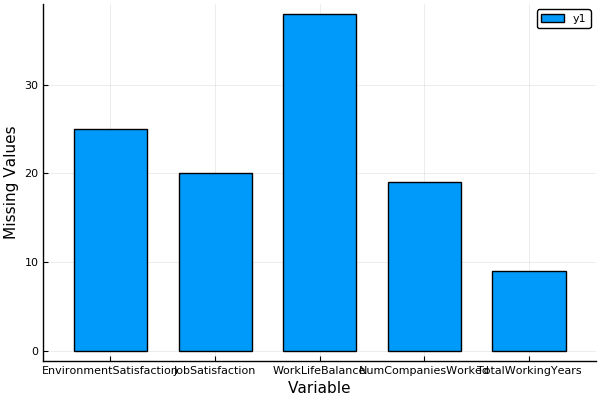

In [12]:
#11. Graph of the missing values
@df many_miss Plots.bar(:Variable,:MissingValues,bar_position = :dodge, bar_width=0.7) 
xlabel!("Variable")
ylabel!("Missing Values")

In [13]:
#12. Replace missing values of Total Working Years and Number of Companies worked with median
df[:,:TotalWorkingYears]=Missings.replace( df[:,:TotalWorkingYears] , median(skipmissing(df[:,:TotalWorkingYears])))
df[:,:NumCompaniesWorked]=Missings.replace( df[:,:NumCompaniesWorked] , median(skipmissing(df[:,:NumCompaniesWorked])))

┌ Warning: implicit vector broadcasting in setindex! is deprecated; use `df[:, col_inds] .= Ref(v)` broadcasting assignment to change the columns in place
│   caller = top-level scope at In[13]:1
└ @ Core In[13]:1
┌ Warning: Implicit broadcasting to an existing column in DataFrame assignment is deprecated.Use an explicit broadcast with `df[:, col_ind] .= v`
│   caller = setindex!(::DataFrame, ::Missings.EachReplaceMissing{Array{Union{Missing, Float64},1},Float64}, ::Colon, ::Symbol) at deprecated.jl:1584
└ @ DataFrames /Users/silviaruiz/.julia/packages/DataFrames/yH0f6/src/deprecated.jl:1584
┌ Warning: implicit vector broadcasting in setindex! is deprecated; use `df[:, col_inds] .= Ref(v)` broadcasting assignment to change the columns in place
│   caller = top-level scope at In[13]:3
└ @ Core In[13]:3


Missings.EachReplaceMissing{Array{Union{Missing, Float64},1},Float64}(Union{Missing, Float64}[1.0, 0.0, 1.0, 3.0, 4.0, 3.0, 2.0, 2.0, 0.0, 1.0  …  2.0, 4.0, 6.0, 0.0, 1.0, 3.0, 2.0, 0.0, 0.0, 0.0], 2.0)

In [14]:
sum(ismissing.(df[:, :TotalWorkingYears]))
sum(ismissing.(df[:, :NumCompaniesWorked]))

0

In [15]:
#13. Replace missing values of Employee Survey with the min (we think they did not answer because it was low)
Label_missing=[:EnvironmentSatisfaction,:JobSatisfaction,:WorkLifeBalance]
for x in columns_with_missing
    df[:,x]=collect(Missings.replace( df[:,x] , minimum(skipmissing(df[:,x])) )) 
end

┌ Warning: `setindex!(df::DataFrame, v::AbstractVector, ::Colon, col_ind::ColumnIndex)` is deprecated, use `begin
│     df[!, col_ind] = v
│     df
│ end` instead.
│   caller = top-level scope at In[15]:4
└ @ Core ./In[15]:4


In [16]:
s2=sum(ismissing.(df[:, :EnvironmentSatisfaction]))
s3=sum(ismissing.(df[:, :JobSatisfaction]))
s4=sum(ismissing.(df[:, :WorkLifeBalance]))
s2+s3+s4

0

In [17]:
#14. Some correlation plots

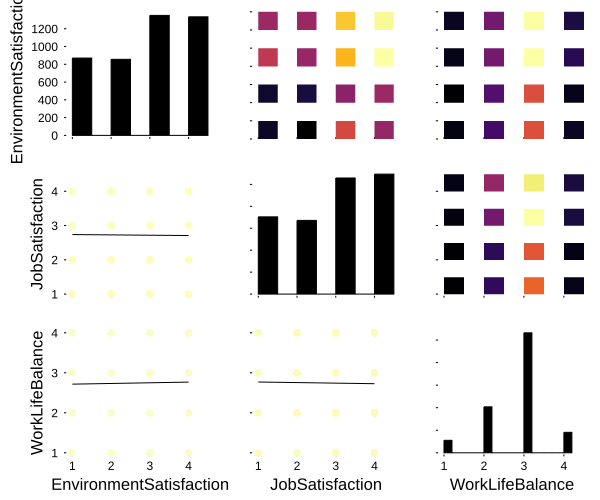

In [18]:

gr(size = (600, 500))
@df df corrplot([:EnvironmentSatisfaction :JobSatisfaction :WorkLifeBalance], grid = false)

In [19]:
@df df cornerplot([:EnvironmentSatisfaction :JobSatisfaction :WorkLifeBalance])

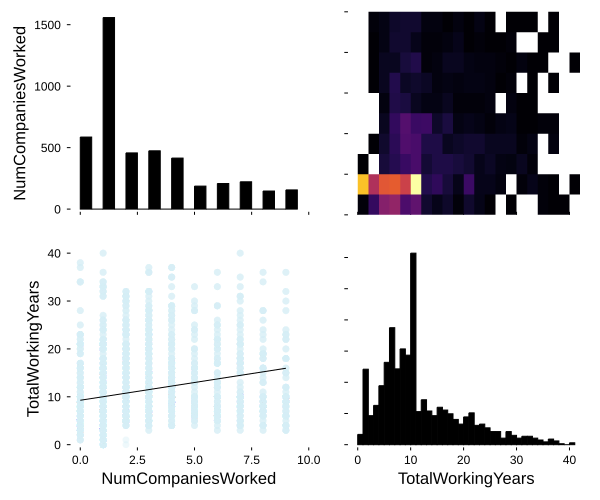

In [20]:
gr(size = (600, 500))
@df df corrplot([:NumCompaniesWorked :TotalWorkingYears], grid = false)

In [21]:
@df df cornerplot([:NumCompaniesWorked :TotalWorkingYears])

In [22]:
#15. First we will transform these categorical variables to one how encoding
label_cat=[:Department,:EducationField,:JobRole,:MaritalStatus] 
unique_label_cat=unique(label_cat)
cats_sets = [unique(df[:, label]) for label in label_cat]

4-element Array{Array{String,1},1}:
 ["Sales", "Research & Development", "Human Resources"]                                                                                                                                              
 ["Life Sciences", "Other", "Medical", "Marketing", "Technical Degree", "Human Resources"]                                                                                                           
 ["Healthcare Representative", "Research Scientist", "Sales Executive", "Human Resources", "Research Director", "Laboratory Technician", "Manufacturing Director", "Sales Representative", "Manager"]
 ["Married", "Single", "Divorced"]                                                                                                                                                                   

In [23]:
#16. This will help us with the names of the columns for one hot encoding
cat_set=[]
for i=1:size(cats_sets,1)
    for j=1:size(cats_sets[i],1)
        println(filter(x -> !isspace(x),string(unique_label_cat[i])*"_"*string(cats_sets[i][j])))
        a=filter(x -> !isspace(x),string(unique_label_cat[i])*"_"*string(cats_sets[i][j]))
        push!(cat_set,a)
    end
end

Department_Sales
Department_Research&Development
Department_HumanResources
EducationField_LifeSciences
EducationField_Other
EducationField_Medical
EducationField_Marketing
EducationField_TechnicalDegree
EducationField_HumanResources
JobRole_HealthcareRepresentative
JobRole_ResearchScientist
JobRole_SalesExecutive
JobRole_HumanResources
JobRole_ResearchDirector
JobRole_LaboratoryTechnician
JobRole_ManufacturingDirector
JobRole_SalesRepresentative
JobRole_Manager
MaritalStatus_Married
MaritalStatus_Single
MaritalStatus_Divorced


In [24]:
#17. Function of one hot encoding
"Computes a onehot vector for every entry in column given a set of categories cats"
function onehot(column, cats=unique(column))
    n1=size(column,1)
    n2=size(cats,1)
    result = zeros(n1,n2)
    for i=1:n1
        for j=1:n2
            if column[i]==cats[j]
                result[i,j]=1 
            end
        end
    end
    result
end

onehot

In [25]:
#18. Generate the one hot encoding and add names to the columns
data_from_cat = hcat([onehot(df[:, label_cat[i]], cats_sets[i]) for i in 1:size(label_cat, 1)]...)
df_cat=DataFrame(data_from_cat)
names!(df_cat, Symbol.(cat_set),makeunique=true) 

,Department_Sales,Department_Research&Development,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,1.0,0.0,0.0,1.0
2,0.0,1.0,0.0,1.0
3,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,1.0
5,0.0,1.0,0.0,0.0
6,0.0,1.0,0.0,1.0
7,0.0,1.0,0.0,0.0
8,0.0,1.0,0.0,1.0
9,0.0,1.0,0.0,1.0


In [26]:
#19. Now we will procede with the rank hot encoding
function rankhot(column, n)
    m=size(column,1)
    result=zeros(m,n-1)
    for i=1:m
        for j=1:n-1
            if j<column[i]
                result[i,j]=1
            end
        end
    end
    return result
end

rankhot (generic function with 1 method)

In [27]:
#20. First we have to modify the variable Stock Option Level, as it should be on a 1-4 ranking instead of a 0-3
df[:,:StockOptionLevel]=df[:,:StockOptionLevel].+1

┌ Warning: `setindex!(df::DataFrame, v::AbstractVector, ::Colon, col_ind::ColumnIndex)` is deprecated, use `begin
│     df[!, col_ind] = v
│     df
│ end` instead.
│   caller = top-level scope at In[27]:1
└ @ Core In[27]:1


4410-element Array{Int64,1}:
 1
 2
 4
 4
 3
 1
 2
 4
 1
 2
 3
 3
 1
 ⋮
 2
 1
 4
 1
 2
 2
 1
 2
 1
 1
 2
 1

In [28]:
label_rank=[:WorkLifeBalance,:EnvironmentSatisfaction,:JobSatisfaction,:JobInvolvement,:PerformanceRating,:JobLevel,:Education,:StockOptionLevel] #done
unique_label_rank=unique(label_rank)
ranks_sets = [sort(unique(df[:, label])) for label in label_rank]

8-element Array{Array{T,1} where T,1}:
 [1.0, 2.0, 3.0, 4.0]
 [1.0, 2.0, 3.0, 4.0]
 [1.0, 2.0, 3.0, 4.0]
 [1, 2, 3, 4]        
 [3, 4]              
 [1, 2, 3, 4, 5]     
 [1, 2, 3, 4, 5]     
 [1, 2, 3, 4]        

In [29]:
ranks_sets[5]=push!(ranks_sets[5],1)
ranks_sets[5]=push!(ranks_sets[5],2)
ranks_sets[5]=sort(unique(ranks_sets[5]))
ranks_sets

8-element Array{Array{T,1} where T,1}:
 [1.0, 2.0, 3.0, 4.0]
 [1.0, 2.0, 3.0, 4.0]
 [1.0, 2.0, 3.0, 4.0]
 [1, 2, 3, 4]        
 [1, 2, 3, 4]        
 [1, 2, 3, 4, 5]     
 [1, 2, 3, 4, 5]     
 [1, 2, 3, 4]        

In [30]:
deleteat!(ranks_sets[1],4)
deleteat!(ranks_sets[2],4)
deleteat!(ranks_sets[3],4)
deleteat!(ranks_sets[4],4)
deleteat!(ranks_sets[5],4)
deleteat!(ranks_sets[6],5)
deleteat!(ranks_sets[7],5)
deleteat!(ranks_sets[8],4)

3-element Array{Int64,1}:
 1
 2
 3

In [31]:
ranks_sets

8-element Array{Array{T,1} where T,1}:
 [1.0, 2.0, 3.0]
 [1.0, 2.0, 3.0]
 [1.0, 2.0, 3.0]
 [1, 2, 3]      
 [1, 2, 3]      
 [1, 2, 3, 4]   
 [1, 2, 3, 4]   
 [1, 2, 3]      

In [32]:
rank_set=[]
for i=1:size(ranks_sets,1)
    for j=1:size(ranks_sets[i],1)
        println(string(unique_label_rank[i])*"_at_least_"*string(ranks_sets[i][j]))
        a=string(unique_label_rank[i])*"_at_least_"*string(ranks_sets[i][j])
        push!(rank_set,a)
    end
end

WorkLifeBalance_at_least_1.0
WorkLifeBalance_at_least_2.0
WorkLifeBalance_at_least_3.0
EnvironmentSatisfaction_at_least_1.0
EnvironmentSatisfaction_at_least_2.0
EnvironmentSatisfaction_at_least_3.0
JobSatisfaction_at_least_1.0
JobSatisfaction_at_least_2.0
JobSatisfaction_at_least_3.0
JobInvolvement_at_least_1
JobInvolvement_at_least_2
JobInvolvement_at_least_3
PerformanceRating_at_least_1
PerformanceRating_at_least_2
PerformanceRating_at_least_3
JobLevel_at_least_1
JobLevel_at_least_2
JobLevel_at_least_3
JobLevel_at_least_4
Education_at_least_1
Education_at_least_2
Education_at_least_3
Education_at_least_4
StockOptionLevel_at_least_1
StockOptionLevel_at_least_2
StockOptionLevel_at_least_3


In [33]:
rank_set

26-element Array{Any,1}:
 "WorkLifeBalance_at_least_1.0"        
 "WorkLifeBalance_at_least_2.0"        
 "WorkLifeBalance_at_least_3.0"        
 "EnvironmentSatisfaction_at_least_1.0"
 "EnvironmentSatisfaction_at_least_2.0"
 "EnvironmentSatisfaction_at_least_3.0"
 "JobSatisfaction_at_least_1.0"        
 "JobSatisfaction_at_least_2.0"        
 "JobSatisfaction_at_least_3.0"        
 "JobInvolvement_at_least_1"           
 "JobInvolvement_at_least_2"           
 "JobInvolvement_at_least_3"           
 "PerformanceRating_at_least_1"        
 "PerformanceRating_at_least_2"        
 "PerformanceRating_at_least_3"        
 "JobLevel_at_least_1"                 
 "JobLevel_at_least_2"                 
 "JobLevel_at_least_3"                 
 "JobLevel_at_least_4"                 
 "Education_at_least_1"                
 "Education_at_least_2"                
 "Education_at_least_3"                
 "Education_at_least_4"                
 "StockOptionLevel_at_least_1"         
 "StockOptionLe

In [34]:
#20. Now we will generate the rank hot encoding for the ranking variables
data_from_rank = hcat(rankhot(df[:,:WorkLifeBalance],4),
                      rankhot(df[:,:EnvironmentSatisfaction],4),
                      rankhot(df[:,:JobSatisfaction],4),
                      rankhot(df[:,:JobInvolvement],4),
                      rankhot(df[:,:PerformanceRating],4),
                      rankhot(df[:,:JobLevel],5),
                      rankhot(df[:,:Education],5),
                      rankhot(df[:,:StockOptionLevel],4))
df_rank=DataFrame(data_from_rank)
names!(df_rank, Symbol.(rank_set),makeunique=true)
#rank_set

,WorkLifeBalance_at_least_1.0,WorkLifeBalance_at_least_2.0,WorkLifeBalance_at_least_3.0
,Float64,Float64,Float64
1,1.0,0.0,0.0
2,1.0,1.0,1.0
3,0.0,0.0,0.0
4,1.0,1.0,0.0
5,1.0,1.0,0.0
6,1.0,0.0,0.0
7,0.0,0.0,0.0
8,1.0,1.0,0.0
9,1.0,1.0,0.0


In [35]:
#21. Now we will standarize the real values
label_boolean=[:Gender,:Attrition] 
labels_real=[:NumCompaniesWorked,:TotalWorkingYears,:Age,:DistanceFromHome,:MonthlyIncome,:PercentSalaryHike,:TrainingTimesLastYear,:YearsAtCompany,:YearsSinceLastPromotion,:YearsWithCurrManager]#done

10-element Array{Symbol,1}:
 :NumCompaniesWorked     
 :TotalWorkingYears      
 :Age                    
 :DistanceFromHome       
 :MonthlyIncome          
 :PercentSalaryHike      
 :TrainingTimesLastYear  
 :YearsAtCompany         
 :YearsSinceLastPromotion
 :YearsWithCurrManager   

In [36]:
function standarize(column)
    M=maximum(column)
    m=minimum(column)
    return (column.-m)./(M-m)
end

standarize (generic function with 1 method)

In [37]:
df_real=df[:,labels_real]

,NumCompaniesWorked,TotalWorkingYears,Age,DistanceFromHome,MonthlyIncome,PercentSalaryHike
,Float64,Float64,Int64,Int64,Int64,Int64
1,1.0,1.0,51,6,131160,11
2,0.0,6.0,31,10,41890,23
3,1.0,5.0,32,17,193280,15
4,3.0,13.0,38,2,83210,11
5,4.0,9.0,32,10,23420,12
6,3.0,28.0,46,8,40710,13
7,2.0,5.0,28,11,58130,20
8,2.0,10.0,29,18,31430,22
9,0.0,10.0,31,1,20440,21


In [38]:
#Data standarization
for x in labels_real
    df_real[:,x]=standarize(df_real[:,x])
end

┌ Warning: `setindex!(df::DataFrame, v::AbstractVector, ::Colon, col_ind::ColumnIndex)` is deprecated, use `begin
│     df[!, col_ind] = v
│     df
│ end` instead.
│   caller = top-level scope at In[38]:3
└ @ Core ./In[38]:3


In [39]:
#22. Now we will convert the business travel variable
label_dict_rank=[:BusinessTravel]

1-element Array{Symbol,1}:
 :BusinessTravel

In [40]:
dict_travel = Dict("Non-Travel" => 1, "Travel_Rarely" => 2, "Travel_Frequently" => 3)

Dict{String,Int64} with 3 entries:
  "Travel_Frequently" => 3
  "Travel_Rarely"     => 2
  "Non-Travel"        => 1

In [41]:
travel_cols=["Travel","Frequently"]

2-element Array{String,1}:
 "Travel"    
 "Frequently"

In [42]:
function stringhot(column,dictionary)
    n=length(dictionary)
    m=size(column,1)
    result=zeros(m,n-1)
    for i=1:m
        for j=1:n-1
            if j<dictionary[column[i]]
                result[i,j]=1
            end
        end
    end
    return result
end

stringhot (generic function with 1 method)

In [43]:
data_from_travel=stringhot(df.BusinessTravel,dict_travel)

4410×2 Array{Float64,2}:
 1.0  0.0
 1.0  1.0
 1.0  1.0
 0.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  0.0
 0.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  0.0
 ⋮       
 1.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  1.0
 1.0  1.0
 1.0  1.0
 1.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  0.0
 1.0  0.0

In [44]:
df_travel=DataFrame(data_from_travel)
names!(df_travel, Symbol.(travel_cols),makeunique=true)

,Travel,Frequently
,Float64,Float64
1,1.0,0.0
2,1.0,1.0
3,1.0,1.0
4,0.0,0.0
5,1.0,0.0
6,1.0,0.0
7,1.0,0.0
8,1.0,0.0
9,1.0,0.0


In [45]:
data_gender=gender_num.(df.Gender)
data_attrition1=attrition_num.(df.Attrition)
data_attrition2=attrition_num2.(df.Attrition)
prueba=hcat(data_gender,data_attrition1,data_attrition2)
bool_cols=["Female","Attrition1","Attrition2"]
df_bool=DataFrame(prueba)
names!(df_bool, Symbol.(bool_cols),makeunique=true)

,Female,Attrition1,Attrition2
,Int64,Int64,Int64
1,1,-1,0
2,1,1,1
3,0,-1,0
4,0,-1,0
5,0,-1,0
6,1,-1,0
7,0,1,1
8,0,-1,0
9,0,-1,0


In [46]:
data=hcat(df_cat,df_rank,df_real,df_travel,df_bool)


,Department_Sales,Department_Research&Development,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,1.0,0.0,0.0,1.0
2,0.0,1.0,0.0,1.0
3,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,1.0
5,0.0,1.0,0.0,0.0
6,0.0,1.0,0.0,1.0
7,0.0,1.0,0.0,0.0
8,0.0,1.0,0.0,1.0
9,0.0,1.0,0.0,1.0


In [47]:
CSV.write("FinalData.csv",  data, writeheader=true)

"FinalData.csv"

In [48]:
target1=data[:,:Attrition1]
target2=data[:,:Attrition2]

4410-element Array{Int64,1}:
 0
 1
 0
 0
 0
 0
 1
 0
 0
 0
 0
 0
 0
 ⋮
 0
 0
 0
 0
 1
 0
 0
 0
 0
 0
 0
 0

┌ Warning: `getindex(df::DataFrame, col_ind::ColumnIndex)` is deprecated, use `df[!, col_ind]` instead.
│   caller = top-level scope at In[49]:1
└ @ Core In[49]:1
┌ Warning: `getindex(df::DataFrame, col_ind::ColumnIndex)` is deprecated, use `df[!, col_ind]` instead.
│   caller = top-level scope at In[49]:3
└ @ Core In[49]:3
┌ Warning: Keyword argument bar_position not supported with Plots.GRBackend().  Choose from: Set(Symbol[:top_margin, :group, :background_color, :yforeground_color_text, :yguidefontcolor, :seriesalpha, :legendfontcolor, :seriescolor, :ztick_direction, :zlims, :overwrite_figure, :xguidefonthalign, :normalize, :linestyle, :xflip, :fillcolor, :ygrid, :background_color_inside, :zguidefonthalign, :bins, :yscale, :xtickfontcolor, :xguide, :fillalpha, :tick_direction, :yguidefontsize, :legendfontfamily, :foreground_color, :xtickfonthalign, :x, :ytickfontrotation, :legend, :discrete_values, :ytick_direction, :xguidefontrotation, :ribbon, :tickfontrotation, :xdiscrete_values,

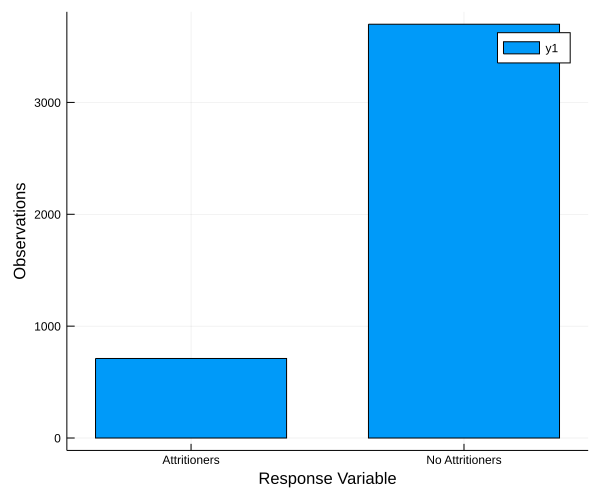

In [49]:
#df[df[:A] % 2.== 0, :]
data_attritioners=data[data[:Attrition2].==1,:]
data_no_attritioners=data[data[:Attrition2].==0,:]

X=["Attritioners", "No Attritioners"]
Y=[size(data_attritioners,1),size(data_no_attritioners,1)]
att=DataFrame(hcat(X,Y))


@df att Plots.bar(:x1,:x2,bar_position = :dodge, bar_width=0.7) 
xlabel!("Response Variable")
ylabel!("Observations")
#sum(data[:,:Attrition2])

In [50]:
#We want to bootstrap our Attrition data set to balance the observations of Attritioners and No Attritioners
n1=size(data_attritioners,1)
n2=size(data_no_attritioners,1)

3699

In [51]:
m=size(data_attritioners,1)
n=size(data_no_attritioners,1)
D=zeros(n,size(data_attritioners,2))
x=rand(1:m)
D[1,:]=convert(Array,data_attritioners[x,:])

┌ Warning: `convert(::Type{Array}, dfr::DataFrameRow)` is deprecated, use `permutedims(Vector(dfr))` instead.
│   caller = top-level scope at In[51]:5
└ @ Core In[51]:5


1×62 Array{Float64,2}:
 0.0  1.0  0.0  0.0  1.0  0.0  0.0  0.0  …  0.0  0.0  1.0  0.0  0.0  1.0  1.0

In [52]:
function sample_data(data,n)
    cols=size(data,2)
    D=zeros(n, cols)
    m=size(data,1)
    for i=1:n
        x=rand(1:m)
        D[i,:]=convert(Array,data[x,:])
    end
    return D
end

sample_data (generic function with 1 method)

In [53]:
oversampling_attritioners=sample_data(data_attritioners,n2)
colnames=[:Department_Sales
    ,:Department_ResearchDevelopment
    ,:Department_HumanResources
    ,:EducationField_LifeSciences
    ,:EducationField_Other
    ,:EducationField_Medical
    ,:EducationField_Marketing
    ,:EducationField_TechnicalDegree
    ,:EducationField_HumanResources
    ,:JobRole_HealthcareRepresentative
    ,:JobRole_ResearchScientist
    ,:JobRole_SalesExecutive
    ,:JobRole_HumanResources
    ,:JobRole_ResearchDirector
    ,:JobRole_LaboratoryTechnician
    ,:JobRole_ManufacturingDirector
    ,:JobRole_SalesRepresentative
    ,:JobRole_Manager
    ,:MaritalStatus_Married
    ,:MaritalStatus_Single
    ,:MaritalStatus_Divorced
    ,:WorkLifeBalance_at_least_1
    ,:WorkLifeBalance_at_least_2
    ,:WorkLifeBalance_at_least_3
    ,:EnvironmentSatisfaction_at_least_1
    ,:EnvironmentSatisfaction_at_least_2
    ,:EnvironmentSatisfaction_at_least_3
    ,:JobSatisfaction_at_least_1
    ,:JobSatisfaction_at_least_2
    ,:JobSatisfaction_at_least_3
    ,:JobInvolvement_at_least_1
    ,:JobInvolvement_at_least_2
    ,:JobInvolvement_at_least_3
    ,:PerformanceRating_at_least_1
    ,:PerformanceRating_at_least_2
    ,:PerformanceRating_at_least_3
    ,:JobLevel_at_least_1
    ,:JobLevel_at_least_2
    ,:JobLevel_at_least_3
    ,:JobLevel_at_least_4
    ,:Education_at_least_1
    ,:Education_at_least_2
    ,:Education_at_least_3
    ,:Education_at_least_4
    ,:StockOptionLevel_at_least_1
    ,:StockOptionLevel_at_least_2
    ,:StockOptionLevel_at_least_3
    ,:NumCompaniesWorked
    ,:TotalWorkingYears
    ,:Age
    ,:DistanceFromHome
    ,:MonthlyIncome
    ,:PercentSalaryHike
    ,:TrainingTimesLastYear
    ,:YearsAtCompany
    ,:YearsSinceLastPromotion
    ,:YearsWithCurrManager
    ,:Travel
    ,:Frequently
    ,:Female
    ,:Attrition1
    ,:Attrition2]
data_oversampling_attritioners=DataFrame(oversampling_attritioners)
names!(data_oversampling_attritioners, Symbol.(colnames),makeunique=true)
names!(data_no_attritioners,Symbol.(colnames),makeunique=true)

┌ Warning: `convert(::Type{Array}, dfr::DataFrameRow)` is deprecated, use `permutedims(Vector(dfr))` instead.
│   caller = sample_data(::DataFrame, ::Int64) at In[52]:7
└ @ Main ./In[52]:7


,Department_Sales,Department_ResearchDevelopment,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,1.0,0.0,0.0,1.0
2,0.0,1.0,0.0,0.0
3,0.0,1.0,0.0,1.0
4,0.0,1.0,0.0,0.0
5,0.0,1.0,0.0,1.0
6,0.0,1.0,0.0,1.0
7,0.0,1.0,0.0,1.0
8,0.0,1.0,0.0,0.0
9,0.0,1.0,0.0,0.0


In [54]:
size(data_oversampling_attritioners,1)

3699

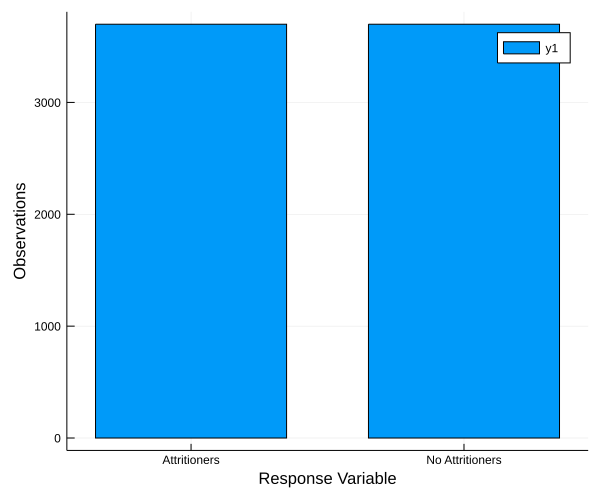

In [55]:
#df[df[:A] % 2.== 0, :]

X1=["Attritioners", "No Attritioners"]
Y1=[size(data_oversampling_attritioners,1),size(data_no_attritioners,1)]
att1=DataFrame(hcat(X1,Y1))


@df att1 Plots.bar(:x1,:x2,bar_position = :dodge, bar_width=0.7) 
xlabel!("Response Variable")
ylabel!("Observations")
#sum(data[:,:Attrition2])

In [56]:
data_oversampling=vcat(data_oversampling_attritioners,data_no_attritioners)
data_oversampling = data_oversampling[shuffle(1:size(data_oversampling, 1)),:]

,Department_Sales,Department_ResearchDevelopment,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,1.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0
4,0.0,1.0,0.0,1.0
5,0.0,1.0,0.0,1.0
6,0.0,1.0,0.0,0.0
7,0.0,0.0,1.0,1.0
8,0.0,1.0,0.0,1.0
9,0.0,1.0,0.0,0.0


In [57]:
@df data corrplot([:Age :TotalWorkingYears :PerformanceRating_at_least_3 :PercentSalaryHike], grid = true)

In [58]:
# Here we will check how to oversampling affects the correlation plots
@df data_oversampling corrplot([:Age :TotalWorkingYears :PerformanceRating_at_least_3 :PercentSalaryHike], grid = true)

In [59]:
target1_over=data_oversampling[:,:Attrition1]
target2_over=data_oversampling[:,:Attrition2]

7398-element Array{Float64,1}:
 0.0
 0.0
 1.0
 1.0
 0.0
 0.0
 0.0
 0.0
 0.0
 1.0
 1.0
 1.0
 0.0
 ⋮  
 1.0
 1.0
 1.0
 1.0
 0.0
 0.0
 0.0
 1.0
 0.0
 1.0
 1.0
 0.0

In [60]:
data_over=convert(Matrix,data_oversampling)

7398×62 Array{Float64,2}:
 1.0  0.0  0.0  0.0  0.0  0.0  1.0  …  0.470588   1.0  1.0  1.0  -1.0  0.0
 1.0  0.0  0.0  0.0  0.0  1.0  0.0     0.0        1.0  1.0  0.0  -1.0  0.0
 1.0  0.0  0.0  0.0  1.0  0.0  0.0     0.0        0.0  0.0  0.0   1.0  1.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.411765   1.0  1.0  1.0   1.0  1.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.411765   1.0  0.0  1.0  -1.0  0.0
 0.0  1.0  0.0  0.0  0.0  1.0  0.0  …  0.411765   1.0  0.0  1.0  -1.0  0.0
 0.0  0.0  1.0  1.0  0.0  0.0  0.0     0.117647   1.0  0.0  1.0  -1.0  0.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.235294   1.0  0.0  0.0  -1.0  0.0
 0.0  1.0  0.0  0.0  0.0  0.0  0.0     0.235294   1.0  0.0  1.0  -1.0  0.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.176471   1.0  0.0  0.0   1.0  1.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0  …  0.0588235  1.0  0.0  1.0   1.0  1.0
 1.0  0.0  0.0  0.0  0.0  0.0  1.0     0.117647   1.0  0.0  0.0   1.0  1.0
 1.0  0.0  0.0  1.0  0.0  0.0  0.0     0.705882   1.0  1.0  1.0  -1.0  0.0

In [61]:
#Now we are undersampling the no attrioners
function undersampling(data, n)
    cols=size(data,2)
    D=zeros(n, cols)
    count=zeros(n,1)
    m=size(data,1)
    for i=1:n
        x=rand(1:m)
        D[i,:]=convert(Array,data[x,:])
    end
    return D
end


undersampling (generic function with 1 method)

In [62]:
under_no_attritioners=undersampling(data_no_attritioners,n1)
data_undersampling_no_attritioners=DataFrame(under_no_attritioners)
names!(data_undersampling_no_attritioners, Symbol.(colnames),makeunique=true)
names!(data_attritioners,Symbol.(colnames),makeunique=true)

┌ Warning: `convert(::Type{Array}, dfr::DataFrameRow)` is deprecated, use `permutedims(Vector(dfr))` instead.
│   caller = undersampling(::DataFrame, ::Int64) at In[61]:9
└ @ Main ./In[61]:9


,Department_Sales,Department_ResearchDevelopment,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,0.0,1.0,0.0,1.0
2,0.0,1.0,0.0,0.0
3,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,0.0
5,0.0,1.0,0.0,0.0
6,0.0,1.0,0.0,0.0
7,0.0,1.0,0.0,1.0
8,0.0,1.0,0.0,1.0
9,0.0,1.0,0.0,0.0


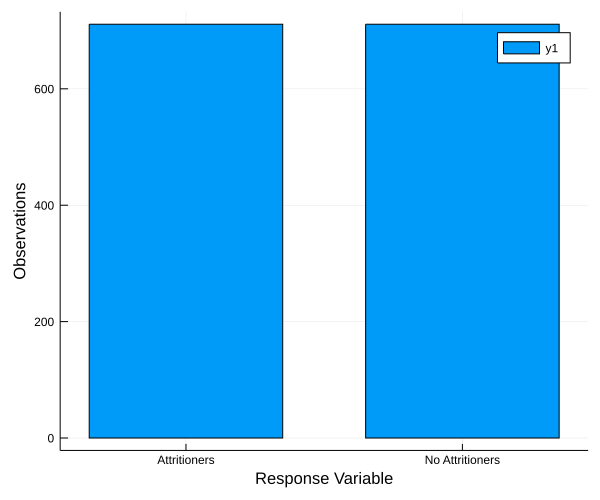

In [63]:
X2=["Attritioners", "No Attritioners"]
Y2=[size(data_undersampling_no_attritioners,1),size(data_attritioners,1)]
att2=DataFrame(hcat(X2,Y2))


@df att2 Plots.bar(:x1,:x2,bar_position = :dodge, bar_width=0.7) 
xlabel!("Response Variable")
ylabel!("Observations")
#sum(data[:,:Attrition2])

In [64]:
data_under=vcat(data_undersampling_no_attritioners,data_attritioners)
data_under= data_under[shuffle(1:size(data_under, 1)),:]

,Department_Sales,Department_ResearchDevelopment,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,0.0,1.0,0.0,0.0
2,0.0,1.0,0.0,1.0
3,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,1.0
5,0.0,1.0,0.0,0.0
6,1.0,0.0,0.0,1.0
7,0.0,1.0,0.0,1.0
8,0.0,1.0,0.0,0.0
9,0.0,1.0,0.0,1.0


In [65]:
target1_under=data_under[:,:Attrition1]
target2_under=data_under[:,:Attrition2]

1422-element Array{Float64,1}:
 0.0
 1.0
 1.0
 1.0
 0.0
 1.0
 0.0
 1.0
 1.0
 1.0
 0.0
 1.0
 0.0
 ⋮  
 0.0
 1.0
 0.0
 0.0
 1.0
 0.0
 0.0
 1.0
 1.0
 1.0
 0.0
 1.0

In [66]:
function partitionTrainTest2(data,p)
    sample = randsubseq(1:size(data,1), p)
    trainingset = data[sample, :]
    notsample = [i for i in 1:size(data,1) if isempty(searchsorted(sample, i))]
    testset = data[notsample, :]
    return trainingset,testset
end

partitionTrainTest2 (generic function with 1 method)

In [67]:
data_under

,Department_Sales,Department_ResearchDevelopment,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,0.0,1.0,0.0,0.0
2,0.0,1.0,0.0,1.0
3,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,1.0
5,0.0,1.0,0.0,0.0
6,1.0,0.0,0.0,1.0
7,0.0,1.0,0.0,1.0
8,0.0,1.0,0.0,0.0
9,0.0,1.0,0.0,1.0


In [68]:
Xtrain,Xtest=partitionTrainTest2(data,0.75)
ytrain1=Xtrain[:,:Attrition1]
ytest1=Xtest[:,:Attrition1]
ytrain2=Xtrain[:,:Attrition2]
ytest2=Xtest[:,:Attrition2]

Xtrain_over,Xtest_over=partitionTrainTest2(data_oversampling,0.75)
ytrain1_over=Xtrain_over[:,:Attrition1]
ytest1_over=Xtest_over[:,:Attrition1]
ytrain2_over=Xtrain_over[:,:Attrition2]
ytest2_over=Xtest_over[:,:Attrition2]

Xtrain_under,Xtest_under=partitionTrainTest2(data_under,0.75)
ytrain1_under=Xtrain_under[:,:Attrition1]
ytest1_under=Xtest_under[:,:Attrition1]
ytrain2_under=Xtrain_under[:,:Attrition2]
ytest2_under=Xtest_under[:,:Attrition2]


405-element Array{Float64,1}:
 1.0
 0.0
 1.0
 1.0
 1.0
 0.0
 1.0
 1.0
 1.0
 1.0
 0.0
 1.0
 0.0
 ⋮  
 1.0
 1.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 1.0

In [69]:
CSV.write("Train.csv",  Xtrain, writeheader=true)
CSV.write("Test.csv",  Xtest, writeheader=true)

"Test.csv"

In [70]:
CSV.write("Train_over.csv",Xtrain_over,writeheader=true)
CSV.write("Test_over.csv",Xtest_over,writeheader=true)

"Test_over.csv"

In [71]:
CSV.write("Train_under.csv",Xtrain_under,writeheader=true)
CSV.write("Test_under.csv",Xtest_under,writeheader=true)

"Test_under.csv"

In [69]:
delete!(Xtrain, :Attrition1)
delete!(Xtrain, :Attrition2)
delete!(Xtrain_over, :Attrition1)
delete!(Xtrain_over, :Attrition2)
delete!(Xtrain_under, :Attrition1)
delete!(Xtrain_under, :Attrition2)
delete!(Xtest, :Attrition1)
delete!(Xtest, :Attrition2)
delete!(Xtest_over, :Attrition1)
delete!(Xtest_over, :Attrition2)
delete!(Xtest_under, :Attrition1)
delete!(Xtest_under, :Attrition2)


┌ Warning: `delete!(df::AbstractDataFrame, cols::Any)` is deprecated, use `select!(df, Not(cols))` instead.
│   caller = top-level scope at In[69]:1
└ @ Core In[69]:1
┌ Warning: `delete!(df::AbstractDataFrame, cols::Any)` is deprecated, use `select!(df, Not(cols))` instead.
│   caller = top-level scope at In[69]:2
└ @ Core In[69]:2
┌ Warning: `delete!(df::AbstractDataFrame, cols::Any)` is deprecated, use `select!(df, Not(cols))` instead.
│   caller = top-level scope at In[69]:3
└ @ Core In[69]:3
┌ Warning: `delete!(df::AbstractDataFrame, cols::Any)` is deprecated, use `select!(df, Not(cols))` instead.
│   caller = top-level scope at In[69]:4
└ @ Core In[69]:4
┌ Warning: `delete!(df::AbstractDataFrame, cols::Any)` is deprecated, use `select!(df, Not(cols))` instead.
│   caller = top-level scope at In[69]:5
└ @ Core In[69]:5
┌ Warning: `delete!(df::AbstractDataFrame, cols::Any)` is deprecated, use `select!(df, Not(cols))` instead.
│   caller = top-level scope at In[69]:6
└ @ Core In[69]:

,Department_Sales,Department_ResearchDevelopment,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,0.0,1.0,0.0,0.0
2,1.0,0.0,0.0,1.0
3,0.0,1.0,0.0,1.0
4,0.0,0.0,1.0,0.0
5,0.0,1.0,0.0,1.0
6,0.0,1.0,0.0,0.0
7,0.0,1.0,0.0,1.0
8,0.0,1.0,0.0,1.0
9,0.0,1.0,0.0,0.0


In [70]:
n=size(Xtrain,1)

3294

In [71]:
Xtrain=convert(Matrix,Xtrain)
Xtest=convert(Matrix,Xtest)
Xtrain_over=convert(Matrix,Xtrain_over)
Xtest_over=convert(Matrix,Xtest_over)
Xtrain_under=convert(Matrix,Xtrain_under)
Xtest_under=convert(Matrix,Xtest_under)

407×60 Array{Float64,2}:
 0.0  1.0  0.0  0.0  1.0  0.0  0.0  …  0.0        0.0       1.0  0.0  1.0
 1.0  0.0  0.0  1.0  0.0  0.0  0.0     0.0        0.0       1.0  0.0  0.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.0        0.117647  1.0  0.0  1.0
 0.0  0.0  1.0  0.0  0.0  1.0  0.0     0.0        0.0       1.0  0.0  0.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.0666667  0.235294  0.0  0.0  0.0
 0.0  1.0  0.0  0.0  0.0  1.0  0.0  …  0.0        0.529412  1.0  0.0  0.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.4        0.0       1.0  0.0  0.0
 0.0  1.0  0.0  1.0  0.0  0.0  0.0     0.0        0.176471  1.0  0.0  0.0
 0.0  1.0  0.0  0.0  0.0  1.0  0.0     0.733333   0.470588  0.0  0.0  1.0
 1.0  0.0  0.0  0.0  0.0  1.0  0.0     0.0        0.117647  1.0  0.0  0.0
 0.0  1.0  0.0  0.0  0.0  1.0  0.0  …  0.0        0.0       0.0  0.0  0.0
 1.0  0.0  0.0  0.0  1.0  0.0  0.0     0.0666667  0.117647  1.0  0.0  1.0
 0.0  1.0  0.0  0.0  1.0  0.0  0.0     0.0666667  0.411765  0.0  0.0  0.0
 ⋮           

In [72]:
function trainLogistic(Xtrain,ytrain)
    n=size(Xtrain,1)
    loss= 1/n*LogisticLoss()
    reg=ZeroReg()
    w_logistic = proxgrad(loss, reg, Xtrain, ytrain, stepsize=1, maxiters=1000)
    return w_logistic
end

trainLogistic (generic function with 1 method)

In [73]:
function evaluate(w,Xtest)
    z = Xtest*w
    return z
end

evaluate (generic function with 42 methods)

In [74]:
function trainLogisticReg(Xtrain,ytrain,λ)
    reg2 = λ2*QuadReg()
    w_logistic = proxgrad(loss, reg2, Xtrain, ytrain2, stepsize=1, maxiters=1000)
    return w_logistic
end

trainLogisticReg (generic function with 1 method)

In [75]:
w_logistic=trainLogistic(Xtrain,ytrain2)
w_logistic_over=trainLogistic(Xtrain_over,ytrain2_over)
w_logistic_under=trainLogistic(Xtrain_under,ytrain2_under)
w_logistic_reg=trainLogisticReg(Xtrain,ytrain2,0.0001)
z = Xtest*w_logistic
z_over = Xtest_over*w_logistic_over
z_under = Xtest_under*w_logistic_under
z_reg = Xtest*w_logistic_reg

MethodError: MethodError: no method matching evaluate(::LogisticLoss, ::Float64, ::Float64)
Closest candidates are:
  evaluate(::LogisticLoss, ::Float64, !Matched::Bool) at /Users/silviaruiz/.julia/packages/LowRankModels/uhtB9/src/losses.jl:304
  evaluate(!Matched::QuadLoss, ::Float64, ::Number) at /Users/silviaruiz/.julia/packages/LowRankModels/uhtB9/src/losses.jl:144
  evaluate(!Matched::L1Loss, ::Float64, ::Number) at /Users/silviaruiz/.julia/packages/LowRankModels/uhtB9/src/losses.jl:158
  ...

In [76]:
pred = z.>0.5
pred_over = z_over.>0.5
pred_under = z_under.>0.5
pred_reg=z_reg.>0.5

#df_test=DataFrame(hcat(ytest2,z1.>0.5))
#test_cols=["Real","Predicted"]
#names!(df_test, Symbol.(test_cols),makeunique=true)
#CSV.write("Predicted.csv",  df_test, writeheader=true)

UndefVarError: UndefVarError: z not defined

In [77]:
#w_logistic=trainLogistic(Xtrain,target2)
#w_logstic2=trainLogisticReg(Xtrain,target2,0.0001)
#z1 = Xtest*w_logistic
#z2 = Xtest*w_logistic2

In [78]:
df_test=DataFrame(hcat(ytest2,pred))
test_cols=["Real normal","Predicted normal"]
names!(df_test, Symbol.(test_cols),makeunique=true)
CSV.write("Predicted_normal.csv",  df_test, writeheader=true)

UndefVarError: UndefVarError: pred not defined

In [79]:
df_test=DataFrame(hcat(ytest2_over,pred_over))
test_cols=["Real over","Predicted over"]
names!(df_test, Symbol.(test_cols),makeunique=true)
CSV.write("Predicted_over.csv",  df_test, writeheader=true)

UndefVarError: UndefVarError: pred_over not defined

In [80]:
df_test=DataFrame(hcat(ytest2_under,pred_under))
test_cols=["Real under","Predicted under"]
names!(df_test, Symbol.(test_cols),makeunique=true)
CSV.write("Predicted_under.csv",  df_test, writeheader=true)

UndefVarError: UndefVarError: pred_under not defined

In [81]:
df_test=DataFrame(hcat(ytest2,pred_reg))
test_cols=["Real reg","Predicted reg"]
names!(df_test, Symbol.(test_cols),makeunique=true)
CSV.write("Predicted_reg.csv",  df_test, writeheader=true)

UndefVarError: UndefVarError: pred_reg not defined

In [82]:
PyPlot.plot(z1, ytest2, "rx", label = L"data $y$")
PyPlot.plot(sort(z1), sort(1 ./(1 .+exp.(-z1))), label = "prediction")
legend()


UndefVarError: UndefVarError: z1 not defined

In [83]:
PyPlot.plot(z2, ytest2, "rx", label = L"data $y$")
PyPlot.plot(sort(z2), sort(1 ./(1 .+exp.(-z2))), label = "prediction")
legend()

UndefVarError: UndefVarError: z2 not defined

In [84]:
z3 = Xtrain*w_logistic

3294-element Array{Float64,1}:
 -3.4871243310563216
 -0.3675938771185754
 -0.928504080282758 
 -4.712322341613431 
 -0.8900290752120188
 -2.759422141645269 
  1.5056510276745574
 -3.213902458642602 
 -4.374206900330898 
 -2.558922208885134 
 -4.726166609056291 
 -2.195018768914438 
 -3.093598413669768 
  ⋮                 
 -0.8160192376259743
 -1.1242406229096138
 -3.5326953661813283
 -3.367950463844806 
 -5.431562301083093 
 -3.45984989104209  
 -1.1959384058723033
 -2.608592048209151 
 -2.067211389705022 
 -0.7221937231327766
 -2.3982366928913126
 -2.0780451643561464

In [85]:
ntrain=size(ytrain2,1)
(ntrain- sum((z3.>0.5).== ytrain2)) / ntrain

0.15391621129326047

In [86]:
ntest=size(ytest2,1)
(ntest- sum((z1.>0.5).== ytest2)) / ntest

UndefVarError: UndefVarError: z1 not defined

In [87]:
sum(z1.>0)
ytest2

UndefVarError: UndefVarError: z1 not defined

In [88]:

(n - sum((z3.>0.5) .== ytrain)) / n

UndefVarError: UndefVarError: ytrain not defined

In [89]:
z4 = Xtrain*w_logistic2
(n - sum((z4.>0.5) .== ytrain)) / n

UndefVarError: UndefVarError: w_logistic2 not defined

In [90]:
target

UndefVarError: UndefVarError: target not defined

In [91]:
loss2 = 1/n*HingeLoss()
λ2 = 0.01
reg = λ2*QuadReg()
w_hinge = proxgrad(loss2, ZeroReg(), Xtrain, ytrain, stepsize=1, maxiters=10000)

UndefVarError: UndefVarError: ytrain not defined

In [92]:
(n - sum(sign.(Xtest*w_hinge) .== ytest)) / n

UndefVarError: UndefVarError: w_hinge not defined

In [93]:
size(data,1)
data2=hcat(data,target2)


,Department_Sales,Department_Research&Development,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,1.0,0.0,0.0,1.0
2,0.0,1.0,0.0,1.0
3,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,1.0
5,0.0,1.0,0.0,0.0
6,0.0,1.0,0.0,1.0
7,0.0,1.0,0.0,0.0
8,0.0,1.0,0.0,1.0
9,0.0,1.0,0.0,1.0


In [94]:
data3=convert(DataFrame, data2)

,Department_Sales,Department_Research&Development,Department_HumanResources,EducationField_LifeSciences
,Float64,Float64,Float64,Float64
1,1.0,0.0,0.0,1.0
2,0.0,1.0,0.0,1.0
3,0.0,1.0,0.0,0.0
4,0.0,1.0,0.0,1.0
5,0.0,1.0,0.0,0.0
6,0.0,1.0,0.0,1.0
7,0.0,1.0,0.0,0.0
8,0.0,1.0,0.0,1.0
9,0.0,1.0,0.0,1.0


In [95]:
CSV.write("dataframe2.csv", data3)

"dataframe2.csv"

In [96]:
X = convert(Array,data); #features
y = convert(Array,target2);  #Y-values
## To see number of training samples
num_tr_ex = length(y); #99

┌ Warning: `convert(::Type{Array}, df::AbstractDataFrame)` is deprecated, use `convert(Matrix, df)` instead.
│   caller = top-level scope at In[96]:1
└ @ Core In[96]:1


In [97]:
W = param(zeros(num_tr_ex))
b = param([0.])

UndefVarError: UndefVarError: param not defined

In [98]:
predict(x) = NNlib.σ.(x*W .+ b)

predict (generic function with 1 method)

In [99]:
loss(x, y) = sum(binarycrossentropy.(predict(x), y))/num_tr_ex

loss (generic function with 1 method)

In [100]:
par = Params([W, b])
## Stocastic Gradient Descent with learning rate 0.01
opt = SGD(par, 0.1; decay = 0)
evalcb() = @show(loss(X, y))

UndefVarError: UndefVarError: W not defined

In [101]:
w_logistic = proxgrad(1/n*LogisticLoss(),ZeroReg(),data,target2,stepsize=1,maxiters=1000)

MethodError: MethodError: no method matching proxgrad_linesearch(::LogisticLoss, ::ZeroReg, ::DataFrame, ::Array{Int64,1}; stepsize=1, maxiters=1000)
Closest candidates are:
  proxgrad_linesearch(::Loss, ::Regularizer, !Matched::Array{Float64,2}, ::Any; maxiters, stepsize, c, w, ch) at /Users/silviaruiz/Documents/Cornell_2019/ORIE_4741/Project/Copia proyecto/proxgrad.jl:24

In [102]:
#plot fit
plotdata()
plotline(w_logistic[1:2],W_lo)




UndefVarError: UndefVarError: plotdata not defined

In [103]:
function MSE(y, pred)
    return sum((y-pred).^2)/size(y,1)
end

MSE (generic function with 1 method)

In [104]:
w_linear=data\target
y_predict=data*w_linear
MSE(target,data*w_linear)

UndefVarError: UndefVarError: target not defined

In [105]:
scatter(target[1:100],(y_predict)[1:100])

UndefVarError: UndefVarError: target not defined

In [106]:
function perceptron(X,y;
                    maxsteps=1000, # 
                    w = rand(size(X,2))) # initial guess for w
    t=1
    running=true
    while t<maxsteps && running
        t=t+1
        running=false
        for i=1:size(X,1)
            if y[i]*transpose(w)*X[i,:]<0
                w=w+y[i]*X[i,:]
                running=true
            end
        end 
    end
    return (w,t)
end

perceptron (generic function with 1 method)

In [107]:
w_final = perceptron(data,target)[1]
y_predict=sign.(data*w_final)
MSE(target,y_predict)

UndefVarError: UndefVarError: target not defined

In [108]:
sum(abs.(y_predict-target))/2

UndefVarError: UndefVarError: y_predict not defined

In [109]:
using PyPlot
import Pkg; Pkg.add("LowRankModels")
# proximal gradient method
include("proxgrad.jl")

 Resolving package versions...
  Updating `~/.julia/environments/v1.2/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.2/Manifest.toml`
 [no changes]


proxgrad_const

In [110]:
"""plot line w*x+b=0"""
function plotline(w::Array{Float64,1},b::Number;
                  xmin=-100,xmax=100,
                  kwargs...)
    x1samples = [xmin, xmax]
    # w[1]*x[1]+w[2]*x[2]+b = 0
    x2samples = (-b - w[1]*x1samples)/w[2]
    plot(x1samples, x2samples, color="black", kwargs...)
end

plotline

# Loss functions for classification

In [111]:
y=target
n = length(y)
Xoffset = [data ones(n)]
loss = 1/n*HingeLoss()
w_hinge = proxgrad(loss, ZeroReg(), Xoffset, y, stepsize=1, maxiters=50000)

UndefVarError: UndefVarError: target not defined